In [1]:
import scanpy as sc
import pandas as pd
import numpy as np
import anndata
import scipy

from scipy.io import mmwrite, mmread
from scipy.sparse import csr_matrix

import sctk

In [2]:
import session_info
session_info.show()

In [17]:
sc.settings.set_figure_params(dpi=120)

# Post-multiVI, Find neighbors, UMAP/Clustering

In [4]:
!ls /nfs/team205/heart/anndata_objects/Foetal/vCM

MultiVI-model_foetal_vCM_feature-select-001
MultiVI-model_foetal_vCM_onlyMultiome_allregion_feature-select-001
MultiVI-model_foetal_vCM_onlyMultiome_allregion_onlyLeft_feature-select-001
MultiVI-model_foetal_vCM_onlyMultiome_allregion_withMouse_feature-select-001
MultiVI-model_foetal_vCM_onlyMultiome_allregion_woCycling_feature-select-001
MultiVI-model_foetal_vCM_onlyMultiome_allregion_woCycling_withMouse_feature-select-001
MultiVI-model_foetal_vCM_onlyMultiome_feature-select-001
MultiVI-model_foetal_vCM_onlyMultiome_only-whole_feature-select-001
MultiVI-post_foetal_vCM_feature-select-001.h5ad
MultiVI-post_foetal_vCM_onlyMultiome_allregion_feature-select-001.h5ad
MultiVI-post_foetal_vCM_onlyMultiome_allregion_onlyLeft_feature-select-001.h5ad
MultiVI-post_foetal_vCM_onlyMultiome_allregion_withMouse_feature-select-001.h5ad
MultiVI-post_foetal_vCM_onlyMultiome_allregion_woCycling_feature-select-001.h5ad
MultiVI-post_foetal_vCM_onlyMultiome_allregion_woCycling_withMouse_feature-select-001.

In [5]:
adata = sc.read_h5ad('/nfs/team205/heart/anndata_objects/Foetal/vCM/MultiVI-post_foetal_vCM_onlyMultiome_allregion_onlyLeft_feature-select-001.h5ad')
adata

AnnData object with n_obs × n_vars = 16451 × 174604
    obs: 'sangerID', 'combinedID', 'donor', 'region', 'age', 'sex', 'facility', 'cell_or_nuclei', 'modality', 'kit_10x', 'week', 'trimester', 'cycling', 'S_score', 'G2M_score', 'phase', 'fine_grain', 'mid_grain', 'coarse_grain', 'batch_key', 'total_counts', 'total_counts_mt', 'total_counts_ribo', 'n_genes_by_counts', 'pct_counts_mt', 'pct_counts_ribo', 'log1p_n_genes_by_counts', 'log1p_total_counts', 'log1p_total_counts_mt', 'log1p_total_counts_ribo', 'scrublet_score', 'doublet_pval', 'doublet_bh_pval', '_indices', '_scvi_batch', '_scvi_labels'
    var: 'modality', 'gene_name_scRNA-0', 'gene_id', 'seqnames', 'start', 'end', 'width', 'strand', 'score', 'replicateScoreQuantile', 'groupScoreQuantile', 'Reproducibility', 'GroupReplicate', 'distToGeneStart', 'nearestGene', 'peakType', 'distToTSS', 'nearestTSS', 'GC', 'idx', 'N', 'n_cells'
    uns: '_scvi_manager_uuid', '_scvi_uuid'
    obsm: 'MultiVI_latent', '_scvi_extra_categorical_covs'

In [6]:
adata.X.data[:10]

array([1., 1., 1., 1., 3., 1., 2., 1., 1., 1.], dtype=float32)

In [7]:
'''
# log-normalise
sc.pp.normalize_total(adata, target_sum=1e4)
sc.pp.log1p(adata)
'''

'\n# log-normalise\nsc.pp.normalize_total(adata, target_sum=1e4)\nsc.pp.log1p(adata)\n'

In [8]:
%%time
sc.pp.neighbors(adata, use_rep="MultiVI_latent",n_neighbors=15)
sc.tl.umap(adata, min_dist=0.2, spread=1.0, n_components=3)
sc.tl.leiden(adata, resolution=0.5, key_added='leiden_MultiVI')

CPU times: user 42.1 s, sys: 7.83 s, total: 50 s
Wall time: 41.6 s


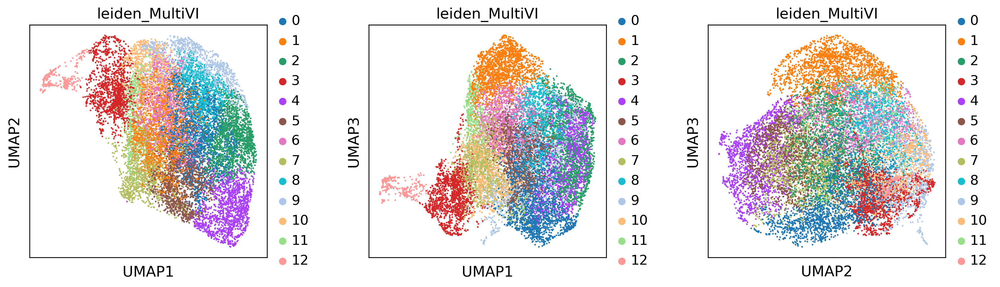

In [18]:
sc.pl.umap(adata, color=['leiden_MultiVI'], size=10, wspace=0.3, components='all', ncols=3)

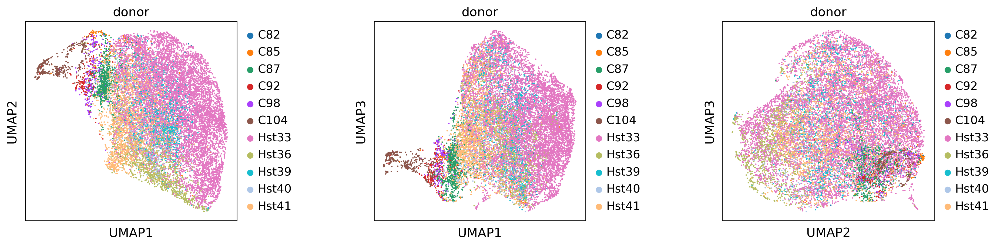

In [19]:
sc.pl.umap(adata, color=['donor'], size=10, wspace=0.5, components='all', ncols=3)

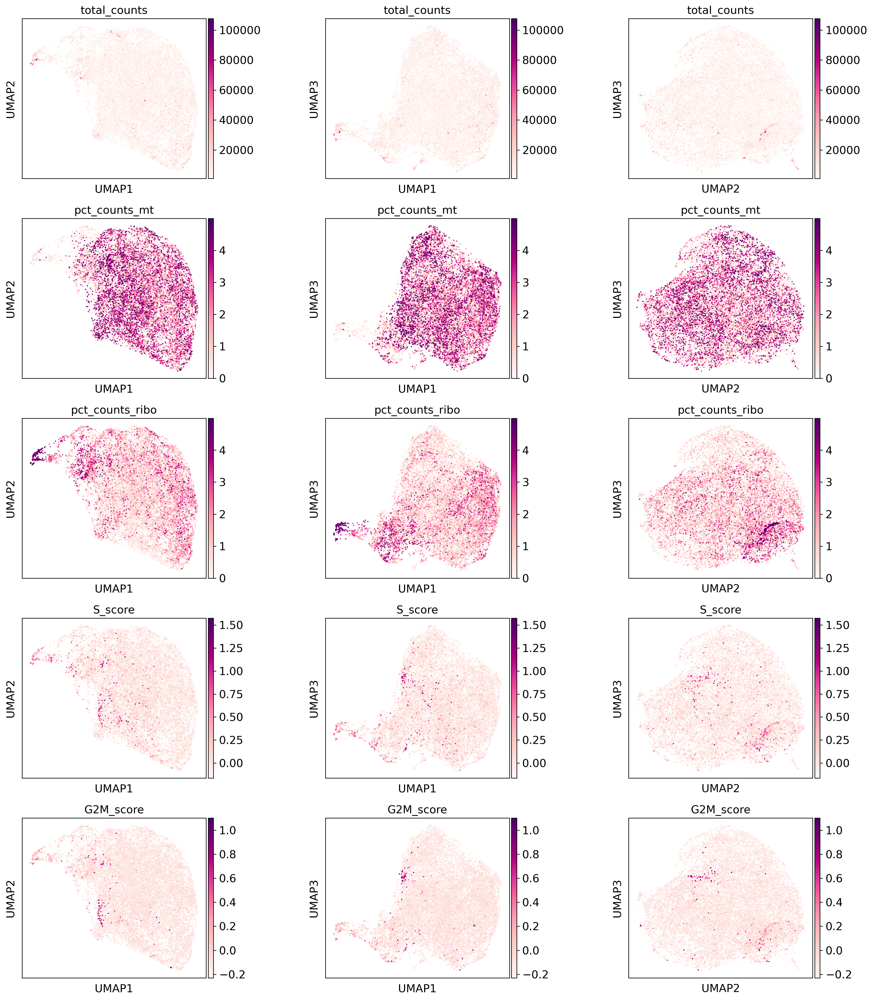

In [20]:
sc.pl.umap(adata, color=['total_counts','pct_counts_mt','pct_counts_ribo',
                                                          'S_score','G2M_score'], 
           size=10, wspace=0.5, components='all', ncols=3, cmap='RdPu')

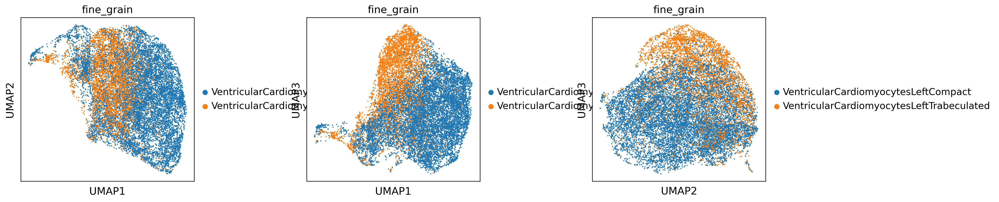

In [21]:
sc.pl.umap(adata, color=['fine_grain'], size=10, wspace=0.5, components='all', ncols=3)

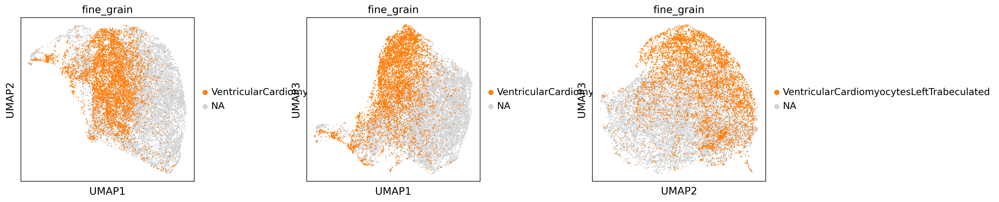

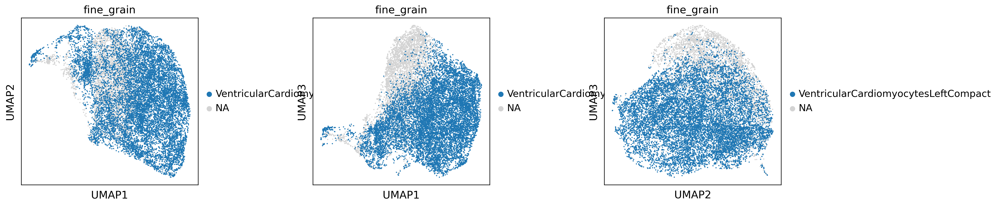

In [22]:
for fine in [
    # 'VentricularCardiomyocytesCycling',
    # 'VentricularCardiomyocytesRightTrabeculated', 
    # 'VentricularCardiomyocytesRightCompact', 
 'VentricularCardiomyocytesLeftTrabeculated', 
 'VentricularCardiomyocytesLeftCompact', 
 ]:
    sc.pl.umap(adata, color=['fine_grain'], groups=[fine], size=10, wspace=0.5, components='all', ncols=3)

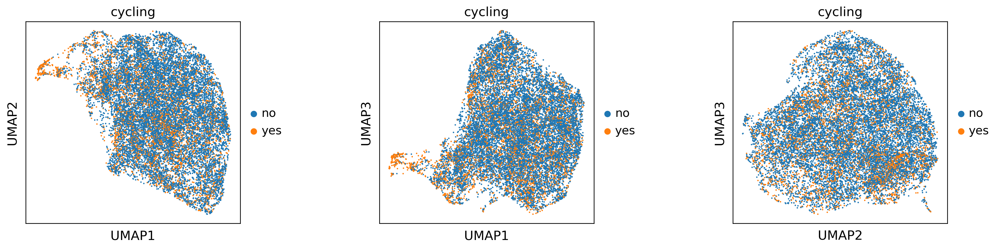

In [23]:
sc.pl.umap(adata, color=['cycling'], size=10, wspace=0.5, components='all', ncols=3)

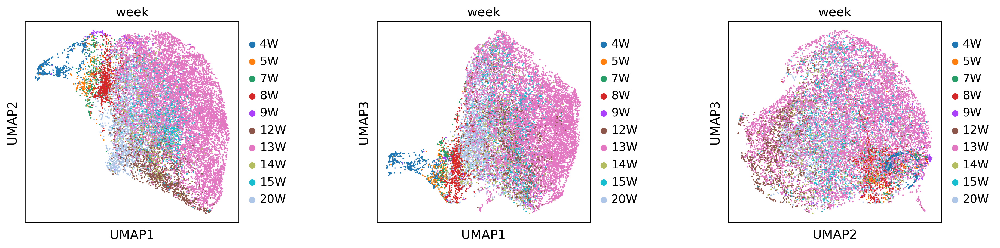

In [24]:
sc.pl.umap(adata, color=['week'], size=10, wspace=0.5, components='all', ncols=3)

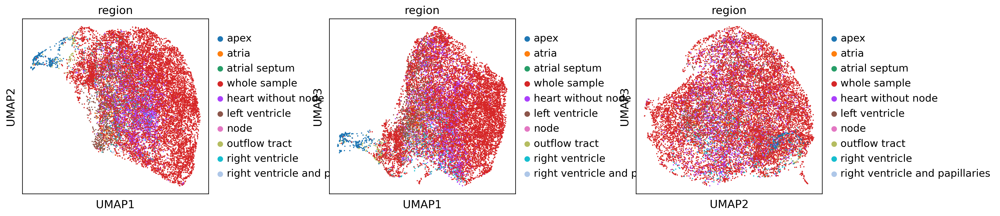

In [25]:
sc.pl.umap(adata, color=['region'], size=10, wspace=0.5, components='all', ncols=3)

# Assess which MultiVI latent space most correlate with age

In [31]:
adata.obs['week']

barcode
BHF_F_Hea11933669_BHF_F_Hea11596622_AATTAGCGTTAGCATG-1      13W
HCAHeartST13386009_HCAHeartST13303419_ATCCTTAGTGGATTGC-1    20W
BHF_F_Hea13188324_BHF_F_Hea13187626_CGAGGCAAGGCTGTCA-1      20W
BHF_F_Hea13188324_BHF_F_Hea13187626_TAGTAAGCACATACTG-1      20W
BHF_F_Hea13188324_BHF_F_Hea13187626_GTTTAACCACGTAATT-1      20W
                                                           ... 
BHF_F_Hea11933669_BHF_F_Hea11596622_GCCCAAATCACATTGA-1      13W
BHF_F_Hea11933667_BHF_F_Hea11596620_CGCAATTAGGTCTTGG-1      13W
BHF_F_Hea11933667_BHF_F_Hea11596620_GCGCTTGCAGGATGGC-1      13W
BHF_F_Hea11933667_BHF_F_Hea11596620_CTCTTGATCATGCGTG-1      13W
BHF_F_Hea11933668_BHF_F_Hea11596621_AACTAGCTCTTGAGGT-1      13W
Name: week, Length: 16451, dtype: category
Categories (10, object): ['4W', '5W', '7W', '8W', ..., '13W', '14W', '15W', '20W']

In [53]:
# get latent space
latent = pd.DataFrame(adata.obsm['MultiVI_latent'])
latent.index = adata.obs_names

# get age (week)
latent['week'] = [int(x.replace('W','')) for x in adata.obs['week']]
# arr = pd.Series([int(x.replace('W','')) for x in adata.obs['week']])

# correlation with week
# res = latent.corrwith(arr, axis=1, method='pearson')
res = latent.corr(method='pearson')['week']
res.sort_values(ascending=False)

week    1.000000
9       0.337589
2       0.233910
1       0.151557
0       0.146214
18      0.123042
10      0.106890
8       0.075663
13     -0.007618
19     -0.033006
6      -0.037545
11     -0.048397
7      -0.091645
15     -0.115572
16     -0.128860
14     -0.142237
12     -0.204365
3      -0.205714
5      -0.224725
4      -0.259518
17     -0.261819
Name: week, dtype: float64

In [48]:
len(arr)

16451

In [60]:
latent.index = [f'cell{x}' for x in range(len(latent))]
latent.to_csv('test.csv')

# Save

In [54]:
adata.write('/nfs/team205/heart/anndata_objects/Foetal/vCM/MultiVI-post_foetal_vCM_onlyMultiome_allregion_onlyLeft_feature-select-001.h5ad')

# Read in (for plotting)

In [ ]:
sc.settings.set_figure_params(dpi=120)

In [ ]:
# adata = sc.read_h5ad('/nfs/team205/heart/anndata_objects/Vitro/multiVI/MultiVI_Foetal_Adult_CMs_Multiome_feature-select-001.h5ad')
# adata

In [ ]:
sc.pl.umap(adata, color=['source'], size=5, wspace=0.5, ncols=1, frameon=False)